<a href="https://colab.research.google.com/github/diegormsouza/jpss/blob/main/JPSS_Solar_Eclipse_2024.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **NOAA-20 Satellite View of the Solar Eclipse from April 8 2024**

**Developed by:** Diego Souza (https://github.com/diegormsouza/jpss) - INPE / CGCT / DISSM (Brazil)

**Latest update:** April 9th 2024

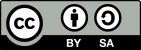

# **Step 1: Installing Condacolab**

With condacolab we can install Conda and friends on Google Colab, easily: https://pypi.org/project/condacolab/

**Note**: You will see a warning when the installion finishes. You may ignore it and just close the popup message. The kernel will restart automatically.

In [1]:
# install libraries with conda (system package manager)
!pip install -q condacolab                                               # install conda and friends on Google Colab, easily
import condacolab                                                        # import condacolab
condacolab.install()                                                     # install condacolab

✨🍰✨ Everything looks OK!


# **Step 2: Installing Polar2Grid and other dependencies**

In this step we will install CSPP Polar2Grid with Conda. There are other ways to install it (as you can see in our reference), but the procedure below worked well on Colab without errors.

**Reference**: https://github.com/ssec/polar2grid

In [2]:
!mamba install -q -c conda-forge polar2grid aggdraw pycoast pydecorate gcsfs requests

Preparing transaction: ...working... done
Verifying transaction: ...working... done
Executing transaction: ...working... done


# **Step 3: Checking if Polar2Grid was correctly installed (built-in documentation):**

Let's check if Polar2Grid has been installed by calling the built-in documentation.

In [3]:
!polar2grid.sh -h

usage: 
    polar2grid.sh -h
see available products:
    polar2grid.sh -r <reader> -w <writer> --list-products -f file1 [file2 ...]
basic processing:
    polar2grid.sh -r <reader> -w <writer> [options] -f file1 [file2 ...]
basic processing with limited products:
    polar2grid.sh -r <reader> -w <writer> [options] -p prod1 prod2 -f file1 [file2 ...]

Load, composite, resample, and save datasets.

options:
  -h, --help            show this help message and exit
  -v, --verbose         each occurrence increases verbosity 1 level through ERROR-WARNING-INFO-
                        DEBUG (default INFO)
  -l LOG_FN, --log LOG_FN
                        specify the log filename
  --progress            Show processing progress bar (Not recommended for logged output)
  --num-workers NUM_WORKERS
                        Specify number of worker threads to use (Default: 4)
  --extra-config-path EXTRA_CONFIG_PATH
                        Specify the base directory of additional Satpy configuration f

# **Step 4: Downloading shapefiles (to be used by add_coastlines.sh)**

In [4]:
# download shapefiles
!wget -c https://www.soest.hawaii.edu/pwessel/gshhg/gshhg-shp-2.3.7.zip -P /content/shapefiles/

# unzip the shapefiles
!unzip -o /content/shapefiles/gshhg-shp-2.3.7.zip -d /content/shapefiles/

--2024-04-09 16:13:47--  https://www.soest.hawaii.edu/pwessel/gshhg/gshhg-shp-2.3.7.zip
Resolving www.soest.hawaii.edu (www.soest.hawaii.edu)... 128.171.151.240
Connecting to www.soest.hawaii.edu (www.soest.hawaii.edu)|128.171.151.240|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 149157845 (142M) [application/zip]
Saving to: ‘/content/shapefiles/gshhg-shp-2.3.7.zip’

gshhg-shp-2.3.7.zip 100%[===================>] 142.25M  5.05MB/s    in 28s     

2024-04-09 16:14:16 (5.01 MB/s) - ‘/content/shapefiles/gshhg-shp-2.3.7.zip’ saved [149157845/149157845]

Archive:  /content/shapefiles/gshhg-shp-2.3.7.zip
  inflating: /content/shapefiles/README.TXT  
  inflating: /content/shapefiles/SHAPEFILES.TXT  
  inflating: /content/shapefiles/LICENSE.TXT  
  inflating: /content/shapefiles/COPYING.LESSERv3  
  inflating: /content/shapefiles/GSHHS_shp/c/GSHHS_c_L1.dbf  
  inflating: /content/shapefiles/GSHHS_shp/c/GSHHS_c_L1.prj  
  inflating: /content/shapefiles/GSHHS_shp/c/GS

# **Step 5: Create folders (for JPSS data samples and shapefiles)**

Just for organization, let's create a couple of folders to store data.

**Note:** In Colab's virtual machine, our working folder is "/content/"

In [5]:
# create a directory to store samples
!mkdir -p jpss_samples

# create a directory to store shapefiles
!mkdir -p shapefiles

# **Step 6: Import the required Python modules**

In [6]:
import gcsfs                      # pythonic file-system for Google Cloud Storage
from google.colab import auth     # colab authentication
from google.cloud import storage  # google cloud storage
from datetime import datetime     # basic date and time types
import pandas as pd               # python data analysis library

# **Step 7: Google Cloud Authentication and Initialization from Colab**

In this step we will allow Colaboratory Runtimes additional access to our Google Account - just follow the steps in the pop-up window.

In [7]:
# Google Cloud authentication and initialization from Colab
auth.authenticate_user()

# **Step 8: Creating Functions for Downloading SDR Files**

In [8]:
def list_blobs(bucket_name, prefix, delimiter=None):
    """Lists all the blobs in the bucket."""

    storage_client = storage.Client()
    blobs = storage_client.list_blobs(bucket_name, prefix=prefix, delimiter=delimiter)
    # note: the call returns a response only when the iterator is consumed.
    results = []
    for blob in blobs:
        # print(blob.name)
        results.append(blob.name)
    return results

def parse_dates_sdr(s):
  #print(s)
  s = (s.split("SDR/"))[1].split(".h5")[0]
  s = s[21:38]
  year = int(s[1:5])
  month = int(s[5:7])
  day = int(s[7:9])
  hour = int(s[11:13])
  minute = int(s[13:15])
  seconds= int(s[15:17])
  string_dt = datetime(year, month, day, hour, minute, seconds)
  return string_dt

def parse_dates_geo(s):
  #print(s)
  s = s[38:56]
  year = int(s[1:5])
  month = int(s[5:7])
  day = int(s[7:9])
  hour = int(s[11:13])
  minute = int(s[13:15])
  seconds= int(s[15:17])
  string_dt = datetime(year, month, day, hour, minute, seconds)
  return string_dt

def download_blob(bucket_name, source_blob_name, destination_file_name):
    """Downloads a blob from the bucket."""
    storage_client = storage.Client()
    bucket = storage_client.get_bucket(bucket_name)
    blob = bucket.blob(source_blob_name)

    blob.download_to_filename(destination_file_name)

    print('Blob {} downloaded to {}.'.format(
        source_blob_name,
        destination_file_name))

#---

def download_jpss_sdr(bucket, band, start, end):
  bucket_name = bucket
  target_data = f"VIIRS-{band}-SDR"

  print(target_data)

  year = start[0:4]
  month = start[5:7]
  day = start[8:10]
  start_hour = start[11:13]
  start_minute = start[14:16]
  end_hour = end[11:13]
  end_minute = end[14:16]

  start_limiter = datetime(int(year), int(month), int(day), int(start_hour), int(start_minute), 0)
  end_limiter = datetime(int(year), int(month), int(day), int(end_hour), int(end_minute), 0)
  fs = gcsfs.GCSFileSystem(anon=True)

  #---

  results = list_blobs(bucket_name, f"{target_data}/{year}/{month}/{day}/", None)
  print('Number of files: ', len(results))

  # instantiates a client
  storage_client = storage.Client()
  dfr = pd.DataFrame(results, columns=['Files'])
  dfr['Date'] = dfr.Files.apply(parse_dates_sdr)

  lets_get = dfr[(dfr.Date >= start_limiter) & (dfr.Date < end_limiter)].Files.to_list()
  print('Filtered to:', len(lets_get))
  lets_get[0:5]

  #---

  for file in lets_get:
    file_name = file.rsplit('/', 1)[-1]
    import os.path
    if (os.path.isfile(f'/content/jpss_samples/{file_name}')):
      print("The file already exists.")
    else:
      download_blob(bucket_name,file,f'/content/jpss_samples/{file_name}')

  #---

  target_data_geo = "VIIRS-IMG-GEO-TC"

  results_geo = list_blobs(bucket_name, f"{target_data_geo}/{year}/{month}/{day}/", None)
  print('Number of files: ', len(results))

  # instantiates a client
  storage_client = storage.Client()
  dfr_geo = pd.DataFrame(results_geo, columns=['Files'])
  dfr_geo['Date'] = dfr_geo.Files.apply(parse_dates_geo)

  lets_get_geo = dfr_geo[(dfr_geo.Date >= start_limiter) & (dfr_geo.Date < end_limiter)].Files.to_list()
  print('Filtered to:', len(lets_get_geo))
  lets_get_geo[0:5]

  #---

  for file in lets_get_geo:
    file_name = file.rsplit('/', 1)[-1]
    import os.path
    if (os.path.isfile(f'/content/jpss_samples/{file_name}')):
      print("The file already exists.")
    else:
      download_blob(bucket_name,file,f'/content/jpss_samples/{file_name}')

  #---

  target_data_geo = "VIIRS-MOD-GEO-TC"

  results_geo = list_blobs(bucket_name, f"{target_data_geo}/{year}/{month}/{day}/", None)
  print('Number of files: ', len(results))

  # instantiates a client
  storage_client = storage.Client()
  dfr_geo = pd.DataFrame(results_geo, columns=['Files'])
  dfr_geo['Date'] = dfr_geo.Files.apply(parse_dates_geo)

  lets_get_geo = dfr_geo[(dfr_geo.Date >= start_limiter) & (dfr_geo.Date < end_limiter)].Files.to_list()
  print('Filtered to:', len(lets_get_geo))
  lets_get_geo[0:5]

  #---

  for file in lets_get_geo:
    file_name = file.rsplit('/', 1)[-1]
    import os.path
    if (os.path.isfile(f'/content/jpss_samples/{file_name}')):
      print("The file already exists.")
    else:
      download_blob(bucket_name,file,f'/content/jpss_samples/{file_name}')

  #---

# **Reference Table:**

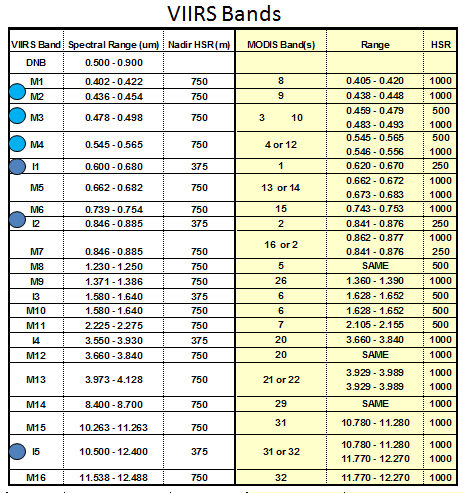

# **Example: NOAA-20 Satellite View of the Solar Eclipse from April 8 2024**

I have verified the passes at the following link:

https://www.ssec.wisc.edu/datacenter/polar_orbit_tracks/data/JPSS-1/2024/2024_04_08_099/GOESEAST.gif

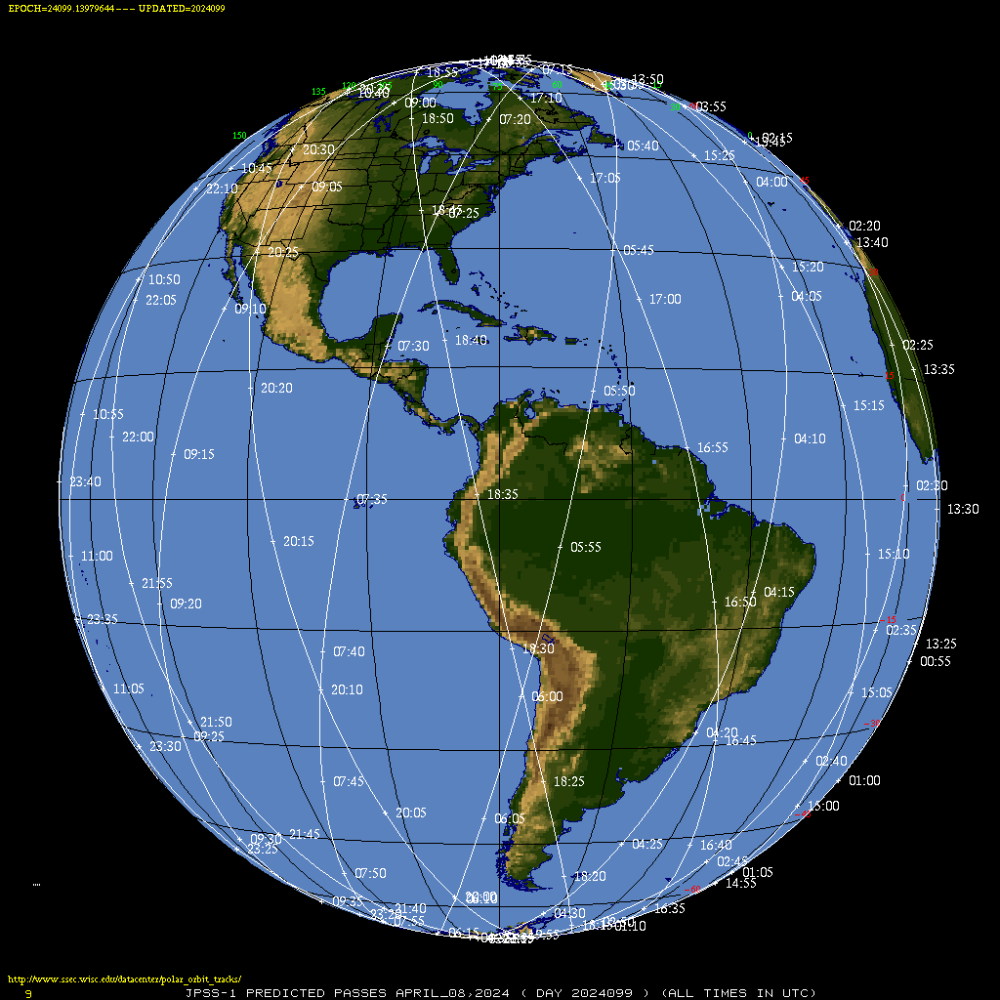

Delete the old files.

In [14]:
!rm -f /content/jpss_samples/*

Download the required datasets.

In [19]:
download_jpss_sdr('noaa-nesdis-n20', 'I2', '2024-04-08 18:41', '2024-04-08 18:48')

# if you want to delete the downloaded files for testing, just use the following command in a new command cell
# !rm -f /content/jpss_samples/*

VIIRS-I2-SDR
Number of files:  1013
Filtered to: 5
The file already exists.
The file already exists.
The file already exists.
The file already exists.
Blob VIIRS-I2-SDR/2024/04/08/SVI02_j01_d20240408_t1847009_e1848254_b33106_c20240408190735097000_oeac_ops.h5 downloaded to /content/jpss_samples/SVI02_j01_d20240408_t1847009_e1848254_b33106_c20240408190735097000_oeac_ops.h5.
Number of files:  1013
Filtered to: 5
The file already exists.
The file already exists.
The file already exists.
The file already exists.
Blob VIIRS-IMG-GEO-TC/2024/04/08/GITCO_j01_d20240408_t1847009_e1848254_b33106_c20240408190544794000_oeac_ops.h5 downloaded to /content/jpss_samples/GITCO_j01_d20240408_t1847009_e1848254_b33106_c20240408190544794000_oeac_ops.h5.
Number of files:  1013
Filtered to: 5
The file already exists.
The file already exists.
The file already exists.
The file already exists.
Blob VIIRS-MOD-GEO-TC/2024/04/08/GMTCO_j01_d20240408_t1847009_e1848254_b33106_c20240408190551938000_oeac_ops.h5 downloade

Check the available products.

In [16]:
!polar2grid.sh -r viirs_sdr -w geotiff --list-products -f /content/jpss_samples/*.h5

INFO     : Sorting and reading input files...
INFO     : Loading product metadata from files...
INFO     : Using default product list: ['i01', 'i02', 'i03', 'i04', 'i05', 'm01', 'm02', 'm03', 'm04', 'm05', 'm06', 'm07', 'm08', 'm09', 'm10', 'm11', 'm12', 'm13', 'm14', 'm15', 'm16', 'adaptive_dnb', 'dynamic_dnb', 'hncc_dnb', 'true_color', 'false_color', 'ifog']
### Custom User Products
<None>

### Standard Available Polar2Grid Products
i02
i02_rad
i_sat_azimuth_angle
i_sat_zenith_angle
i_solar_azimuth_angle
i_solar_zenith_angle
m_sat_azimuth_angle
m_sat_zenith_angle
m_solar_azimuth_angle
m_solar_zenith_angle


Create the GeoTIFF.

In [21]:
!polar2grid.sh -r viirs_sdr -w geotiff -p i02 -f /content/jpss_samples/*.h5

INFO     : Sorting and reading input files...
INFO     : Loading product metadata from files...
INFO     : Loading swath geolocation into memory...
INFO     : Running day coverage filtering...
INFO     : Running night coverage filtering...
INFO     : Computing dynamic grid parameters...
INFO     : Resampling to 'wgs84_fit' using 'ewa' resampling...
INFO     : Computing products and saving data to writers...
INFO     : SUCCESS


Add coastlines and generate the PNG.

In [22]:
!add_coastlines.sh --shapes-dir /content/shapefiles/ --add-coastlines --add-grid --grid-D 10.0 10.0 --grid-d 10.0 10.0 --grid-text-size 20 noaa20_viirs_i02_20240408_184119_wgs84_fit.tif

/usr/local/lib/python3.10/site-packages/polar2grid/add_coastlines.py:42: DeprecationWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html
  from pkg_resources import resource_filename as get_resource_filename


Displaying the image.

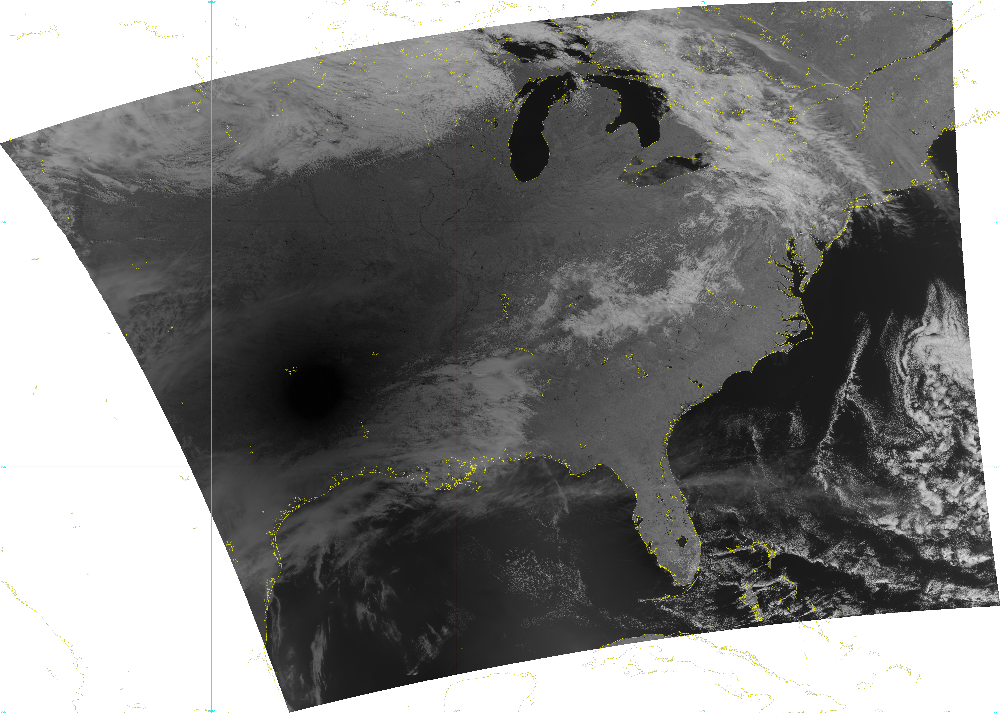

In [23]:
from IPython.display import Image
Image('noaa20_viirs_i02_20240408_184119_wgs84_fit.png')